In [1]:
import dataset, torch, torchvision
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from augmentation import *

# Ignore Warning
import warnings
warnings.filterwarnings(action='ignore')

In [2]:
train_image_dir = '../../../../data/OCR/Jason/COCO/images/train2017/'
train_ann = '../../../../data/OCR/Jason/COCO/annotations/instances_train2017.json'

dataset = dataset.COCO_detection(train_image_dir, train_ann)

loading annotations into memory...
Done (t=28.46s)
creating index...
index created!


In [3]:
ex1, ex2, ex3, ex4 = dataset[2], dataset[25], dataset[28], dataset[42]

In [4]:
M = 10

color_range = torch.arange(0, 0.9+1e-8, (0.9-0)/M).tolist()
rotate_range = torch.arange(0, 30+1e-8, (30-0)/M).tolist()
shear_range = torch.arange(0, 0.3+1e-8, (0.3-0)/M).tolist()
translate_range = torch.arange(0, 250+1e-8, (250-0)/M).tolist()
translate_bbox_range = torch.arange(0, 120+1e-8, (120-0)/M).tolist()


Mag = {'Brightness' : color_range, 'Color' : color_range, 'Contrast' : color_range, 
       'Posterize' : torch.arange(4, 8+1e-8, (8-4)/M).tolist()[::-1], 'Sharpness' : color_range, 
       'Solarize' : torch.arange(0, 256+1e-8, (256-0)/M).tolist()[::-1], 'SolarizeAdd' : torch.arange(0, 110+1e-8, (110-0)/M).tolist(),
       
       'Cutout' : torch.arange(0, 100+1e-8, (100-0)/M).tolist(),
       
       'Rotate_BBox' : rotate_range, 'ShearX_BBox' : shear_range, 'ShearY_BBox' : shear_range,
       'TranslateX_BBox' : translate_range, 'TranslateY_BBox' : translate_range,
           
       'Rotate_Only_BBoxes' : rotate_range, 'ShearX_Only_BBoxes' : shear_range, 'ShearY_Only_BBoxes' : shear_range,
       'TranslateX_Only_BBoxes' : translate_bbox_range, 'TranslateY_Only_BBoxes' : translate_bbox_range,
       
       'Solarize_Only_BBoxes' : torch.arange(0, 256+1e-8, (256-0)/M).tolist()[::-1],
       
       'BBox_Cutout' : torch.arange(0, 0.75+1e-8, (0.75-0)/M).tolist(), 
       'Cutout_Only_BBoxes' : torch.arange(0, 50+1e-8, (50-0)/M).tolist()
      }


Fun = {'Brightness' : Brightness, 'Color' : Color, 'Contrast' : Contrast,
       'Posterize' : Posterize, 'Sharpness' : Sharpness, 'Solarize' : Solarize, 'SolarizeAdd' : SolarizeAdd,
       
       'Cutout' : Cutout,
       
       'Rotate_BBox' : Rotate_BBox, 'ShearX_BBox' : ShearX_BBox, 'ShearY_BBox' : ShearY_BBox,
       'TranslateX_BBox' : TranslateX_BBox, 'TranslateY_BBox' : TranslateY_BBox,
           
       'Rotate_Only_BBoxes' : Rotate_Only_BBoxes, 'ShearX_Only_BBoxes' : ShearX_Only_BBoxes, 'ShearY_Only_BBoxes' : ShearY_Only_BBoxes,
       'TranslateX_Only_BBoxes' : TranslateX_Only_BBoxes, 'TranslateY_Only_BBoxes' : TranslateY_Only_BBoxes, 
       
       'Solarize_Only_BBoxes' : Solarize_Only_BBoxes,
       
       'BBox_Cutout' : BBox_Cutout, 'Cutout_Only_BBoxes' : Cutout_Only_BBoxes
      }

In [5]:
aug_list, title_list = [], []
M = [4, 10]

for f in Fun:
    if f in ['Posterize', 'Solarize', 'SolarizeAdd', 'Cutout']:
        aug_list.append([Fun[f](1, Mag[f][M[0]]), Fun[f](1, Mag[f][M[1]])])
    elif f in ['Solarize_Only_BBoxes', 'BBox_Cutout', 'Cutout_Only_BBoxes']:
        aug_list.append([Fun[f](3, Mag[f][M[0]]), Fun[f](3, Mag[f][M[1]])])
    elif f in ['Rotate_Only_BBoxes', 'ShearX_Only_BBoxes', 'ShearY_Only_BBoxes', 'TranslateX_Only_BBoxes', 'TranslateY_Only_BBoxes']:
        aug_list.append([Fun[f](3, Mag[f][M[0]], minus=False), Fun[f](3, Mag[f][M[1]], minus=False)])
    else:
        aug_list.append([Fun[f](1, Mag[f][M[0]], minus=False), Fun[f](1, Mag[f][M[1]], minus=False)])
    title_list.append(['Function : {}, Magnitude : {}'.format(f, M[0]), 'Function : {}, Magnitude : {}'.format(f, M[1])])

In [6]:
for a, t in zip(aug_list, title_list):
    print(t)
    print()

['Function : Brightness, Magnitude : 4', 'Function : Brightness, Magnitude : 10']

['Function : Color, Magnitude : 4', 'Function : Color, Magnitude : 10']

['Function : Contrast, Magnitude : 4', 'Function : Contrast, Magnitude : 10']

['Function : Posterize, Magnitude : 4', 'Function : Posterize, Magnitude : 10']

['Function : Sharpness, Magnitude : 4', 'Function : Sharpness, Magnitude : 10']

['Function : Solarize, Magnitude : 4', 'Function : Solarize, Magnitude : 10']

['Function : SolarizeAdd, Magnitude : 4', 'Function : SolarizeAdd, Magnitude : 10']

['Function : Cutout, Magnitude : 4', 'Function : Cutout, Magnitude : 10']

['Function : Rotate_BBox, Magnitude : 4', 'Function : Rotate_BBox, Magnitude : 10']

['Function : ShearX_BBox, Magnitude : 4', 'Function : ShearX_BBox, Magnitude : 10']

['Function : ShearY_BBox, Magnitude : 4', 'Function : ShearY_BBox, Magnitude : 10']

['Function : TranslateX_BBox, Magnitude : 4', 'Function : TranslateX_BBox, Magnitude : 10']

['Function : Tra

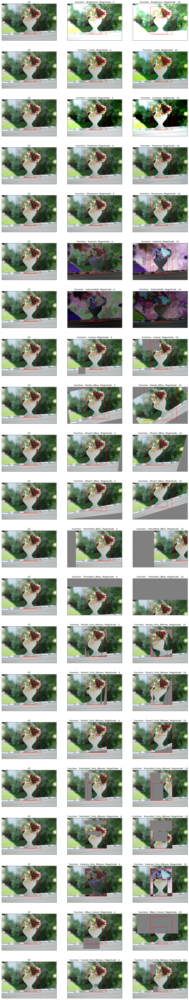

In [7]:
plt.figure(figsize=(20, 110))
plt.rcParams['axes.titlesize'] = 13
plt.axis('off')

for i in range(len(aug_list)):
    plt.subplot(21, 3, 3*i+1)
    image, bboxs, label = ex1
    img = plt.imshow(image); img.axes.get_xaxis().set_visible(False); img.axes.get_yaxis().set_visible(False)
    plt.gca().set_title('GT')
    if bboxs == None: pass
    else:
        for bbox in bboxs:
            min_x, min_y, max_x, max_y = bbox
            plt.gca().add_patch(Rectangle((min_x, min_y), max_x-min_x, max_y-min_y, edgecolor='r', facecolor='none'))
    
    for j in range(len(aug_list[i])):
        plt.subplot(21, 3, 3*i + j + 2)
        aug_image, aug_bboxes = aug_list[i][j](image, bboxs)
        aug_image = plt.imshow(aug_image)
        aug_image.axes.get_xaxis().set_visible(False); aug_image.axes.get_yaxis().set_visible(False)
        plt.gca().set_title(title_list[i][j])
        if aug_bboxes == None: pass
        else:
            for bbox in aug_bboxes:
                min_x, min_y, max_x, max_y = bbox
                plt.gca().add_patch(Rectangle((min_x, min_y), max_x-min_x, max_y-min_y, edgecolor='r', facecolor='none'))

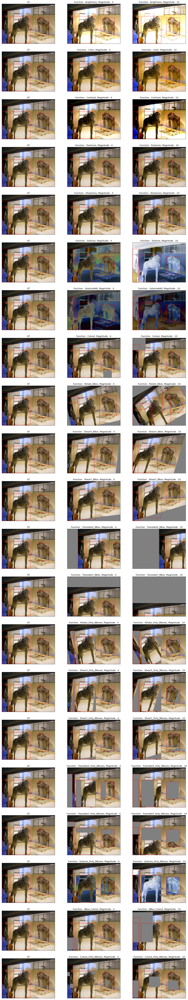

In [8]:
plt.figure(figsize=(20, 110))
plt.rcParams['axes.titlesize'] = 13
plt.axis('off')

for i in range(len(aug_list)):
    plt.subplot(21, 3, 3*i+1)
    image, bboxs, label = ex2
    img = plt.imshow(image); img.axes.get_xaxis().set_visible(False); img.axes.get_yaxis().set_visible(False)
    plt.gca().set_title('GT')
    if bboxs == None: pass
    else:
        for bbox in bboxs:
            min_x, min_y, max_x, max_y = bbox
            plt.gca().add_patch(Rectangle((min_x, min_y), max_x-min_x, max_y-min_y, edgecolor='r', facecolor='none'))
    
    for j in range(len(aug_list[i])):
        plt.subplot(21, 3, 3*i + j + 2)
        aug_image, aug_bboxes = aug_list[i][j](image, bboxs)
        aug_image = plt.imshow(aug_image)
        aug_image.axes.get_xaxis().set_visible(False); aug_image.axes.get_yaxis().set_visible(False)
        plt.gca().set_title(title_list[i][j])
        if aug_bboxes == None: pass
        else:
            for bbox in aug_bboxes:
                min_x, min_y, max_x, max_y = bbox
                plt.gca().add_patch(Rectangle((min_x, min_y), max_x-min_x, max_y-min_y, edgecolor='r', facecolor='none'))

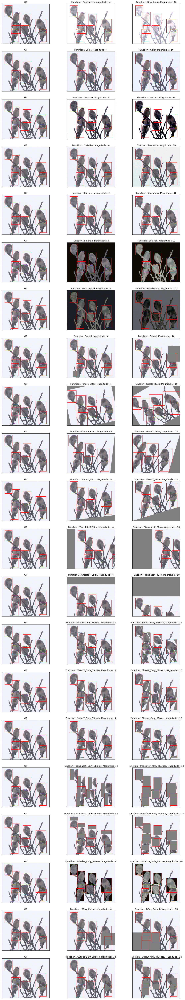

In [9]:
plt.figure(figsize=(20, 110))
plt.rcParams['axes.titlesize'] = 13
plt.axis('off')

for i in range(len(aug_list)):
    plt.subplot(21, 3, 3*i+1)
    image, bboxs, label = ex3
    img = plt.imshow(image); img.axes.get_xaxis().set_visible(False); img.axes.get_yaxis().set_visible(False)
    plt.gca().set_title('GT')
    if bboxs == None: pass
    else:
        for bbox in bboxs:
            min_x, min_y, max_x, max_y = bbox
            plt.gca().add_patch(Rectangle((min_x, min_y), max_x-min_x, max_y-min_y, edgecolor='r', facecolor='none'))
    
    for j in range(len(aug_list[i])):
        plt.subplot(21, 3, 3*i + j + 2)
        aug_image, aug_bboxes = aug_list[i][j](image, bboxs)
        aug_image = plt.imshow(aug_image)
        aug_image.axes.get_xaxis().set_visible(False); aug_image.axes.get_yaxis().set_visible(False)
        plt.gca().set_title(title_list[i][j])
        if aug_bboxes == None: pass
        else:
            for bbox in aug_bboxes:
                min_x, min_y, max_x, max_y = bbox
                plt.gca().add_patch(Rectangle((min_x, min_y), max_x-min_x, max_y-min_y, edgecolor='r', facecolor='none'))

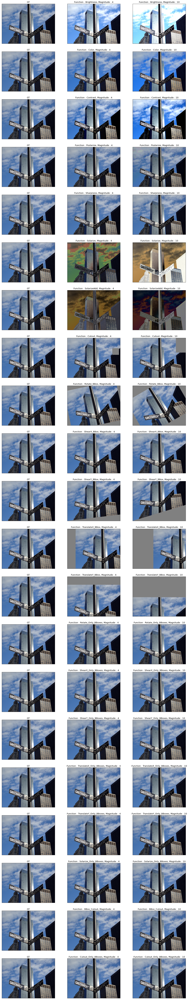

In [10]:
plt.figure(figsize=(20, 110))
plt.rcParams['axes.titlesize'] = 13
plt.axis('off')

for i in range(len(aug_list)):
    plt.subplot(21, 3, 3*i+1)
    image, bboxs, label = ex4
    img = plt.imshow(image); img.axes.get_xaxis().set_visible(False); img.axes.get_yaxis().set_visible(False)
    plt.gca().set_title('GT')
    if bboxs == None: pass
    else:
        for bbox in bboxs:
            min_x, min_y, max_x, max_y = bbox
            plt.gca().add_patch(Rectangle((min_x, min_y), max_x-min_x, max_y-min_y, edgecolor='r', facecolor='none'))
    
    for j in range(len(aug_list[i])):
        plt.subplot(21, 3, 3*i + j + 2)
        aug_image, aug_bboxes = aug_list[i][j](image, bboxs)
        aug_image = plt.imshow(aug_image)
        aug_image.axes.get_xaxis().set_visible(False); aug_image.axes.get_yaxis().set_visible(False)
        plt.gca().set_title(title_list[i][j])
        if aug_bboxes == None: pass
        else:
            for bbox in aug_bboxes:
                min_x, min_y, max_x, max_y = bbox
                plt.gca().add_patch(Rectangle((min_x, min_y), max_x-min_x, max_y-min_y, edgecolor='r', facecolor='none'))